## Image Matching Challenge 2022

https://www.kaggle.com/competitions/image-matching-challenge-2022

### Work with datasets of image

In [1]:
import os
import numpy as np
import cv2
import csv
import matplotlib.pyplot as plt

import kornia as K
import kornia.feature as KF
import kornia_moons.feature
import random

from os import listdir
from os.path import isfile, join

In [2]:
# path to data
src=r'E:\mphti\training\ICM22\train'
# scan directory and select groups
address=[]
group=[]
for i in os.scandir(src):
    
    if os.path.isdir(os.path.join(src, i)): # checking if this is the way
        
        cur=os.path.split(i)[-1] # looking for the name of the current observation scene
        address+=[i.path+'\\images'] # the address to the observation
        group += [cur]

In [3]:
# choose one of the observation scenes
#  for further use
n=3 # number of scene
scene=group[n]
print(scene)

onlyfiles = [f for f in listdir(address[n]) if isfile(join(address[n], f))] # we read all the files on the way
images_dict={} # image store data

for  i in  onlyfiles:
    id=i.split('.')[0] # id - key of image in dictionary
    images_dict[id]=cv2.cvtColor(cv2.imread(f'{address[n]}\{i}'),cv2.COLOR_BGR2RGB)

colosseum_exterior


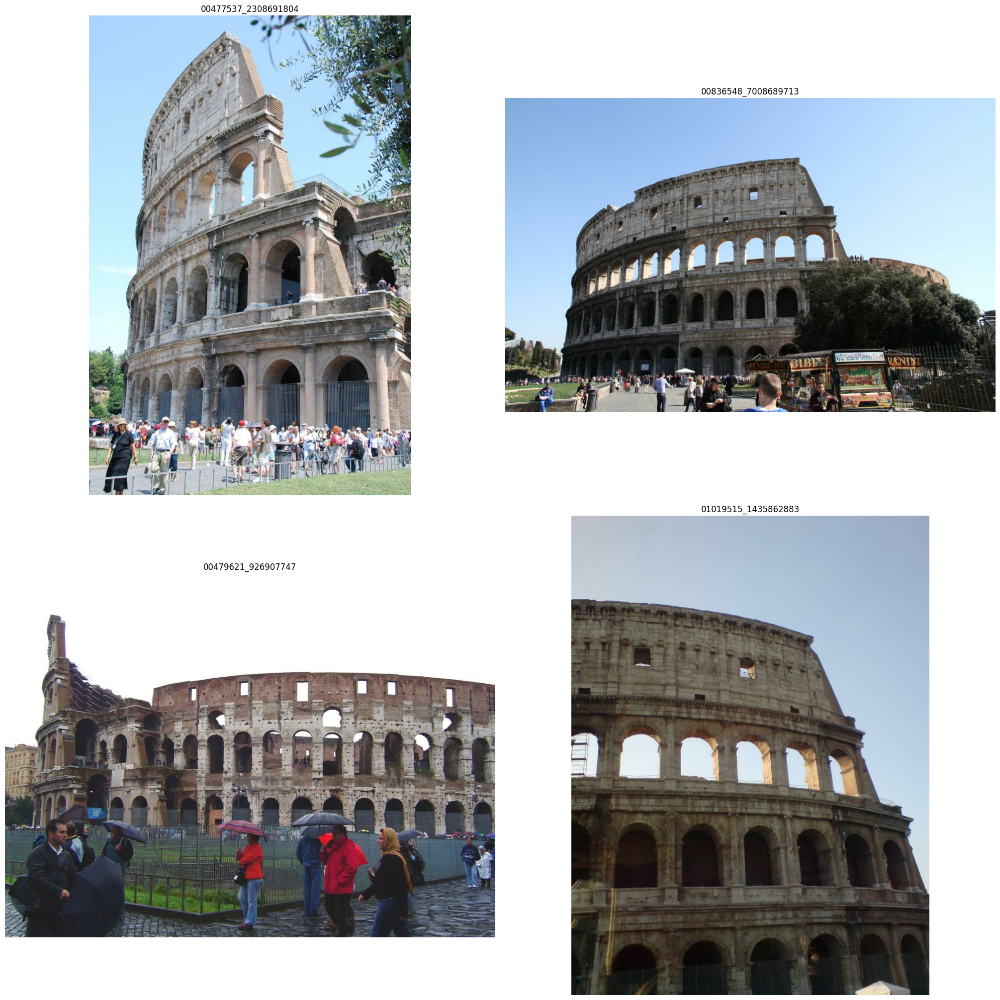

In [4]:
#  check and print data
def image_show(num_rows = 2,num_cols = 2):
    '''imshow image'''
    f, axes = plt.subplots(num_rows, num_cols, figsize=(20, 20), constrained_layout=True)
    for i, key in enumerate(images_dict):
        if i >= num_rows * num_cols:
            break
        cur_ax = axes[i % num_rows, i // num_rows]
        cur_ax.imshow(images_dict[key])
        cur_ax.set_title(key)
        cur_ax.axis('off')

image_show()

In [5]:
def Covisibility(filename):
    covisibility_dict = {}
    with open(filename) as f:
        reader = csv.reader(f, delimiter=',')
        for i, row in enumerate(reader):
            # Skip header.
            if i == 0:
                continue
            row[2]=[float(i) for i in row[2].split()]
            covisibility_dict[row[0]] = [float(row[1]),row[2]] 

    return covisibility_dict

# take information from pair_convisibility.csv
conv_dict = Covisibility(f'{src}/{scene}/pair_covisibility.csv') # различимость

In [6]:
def Calibration(filename):
    calibration={}
    with open(filename) as i:
        l= csv.reader(i,delimiter=',')
        for i ,row in enumerate(l):
            if i==0:
                continue
            row[1]=np.array([float(i) for i in row[1].split()]).reshape([3,3] )
            row[2]=np.array([float(i) for i in row[2].split()]).reshape([3,3] )
            row[3]=[float(i) for i in row[3].split()]
            calibration[row[0]]=[row[1],row[2],row[3]]
    
    return calibration

calibration=Calibration(f'{src}/{scene}/calibration.csv')

In [7]:
keys = list(images_dict.keys())

### Try with opencv 

ORB is basically a fusion of FAST keypoint detector and BRIEF descriptor with many modifications to enhance the performance. First it use FAST to find keypoints, then apply Harris corner measure to find top N points among them. It also use pyramid to produce multiscale-features. But one problem is that, FAST doesn't compute the orientation. So what about rotation invariance? Authors came up with following modification.

It computes the intensity weighted centroid of the patch with located corner at center. The direction of the vector from this corner point to centroid gives the orientation. To improve the rotation invariance, moments are computed with x and y which should be in a circular region of radius r, where r is the size of the patch.

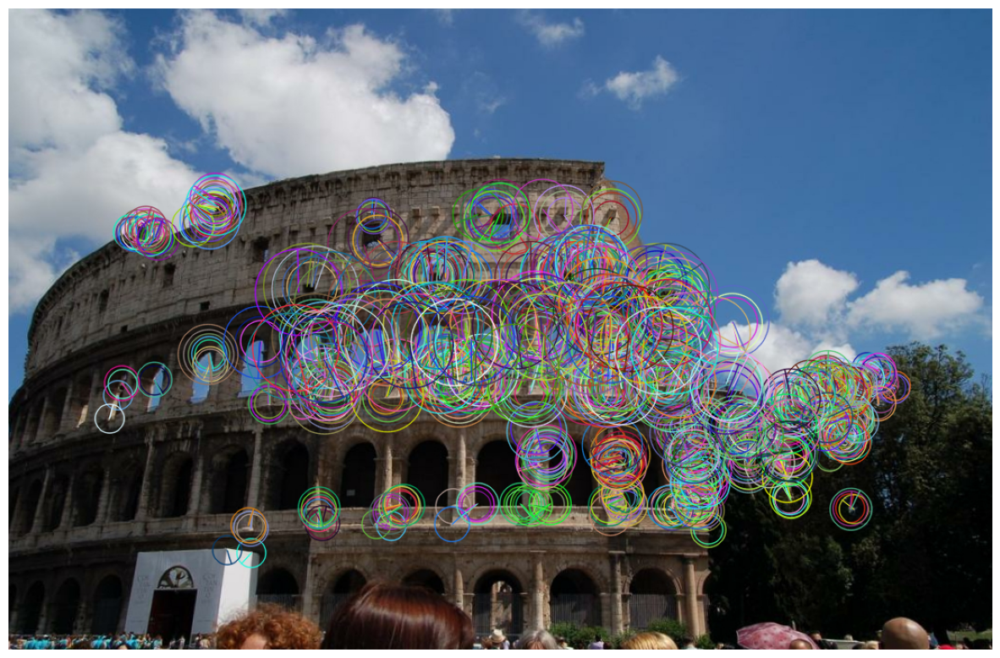

In [8]:
n=67 # chose image
img=cv2.imread(f'{src}/{scene}/images/{keys[n]}.jpg')
gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

n_feature=1000

# use feature detector
orb_detector=cv2.ORB.create(nfeatures=n_feature,edgeThreshold=100,nlevels=9,)
kp,desc=orb_detector.detectAndCompute(gray,None)

image_with_keypoints = cv2.drawKeypoints(images_dict[keys[n]], kp, outImage=None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

fig = plt.figure(figsize=(15, 15))
plt.imshow(image_with_keypoints)
plt.axis('off')
plt.show()

SIFT (Scale-Invariant Feature Transform)- is a computer vision algorithm used to detect and describe local features in images. It was first introduced by David Lowe in 1999 and has since become a widely used technique in various applications, including object recognition, image matching, and 3D reconstruction.

Key Features of SIFT:

1) Scale-invariance: SIFT features are invariant to image scale, meaning that they can be detected and matched across different scales.
2) Rotation-invariance: SIFT features are also invariant to image rotation, making them robust to changes in viewpoint.
3) Affine-invariance: SIFT features are invariant to affine transformations, which include scaling, rotation, and shear.
4) Robustness to noise and occlusion: SIFT features are designed to be robust to noise and occlusion, making them suitable for real-world images.

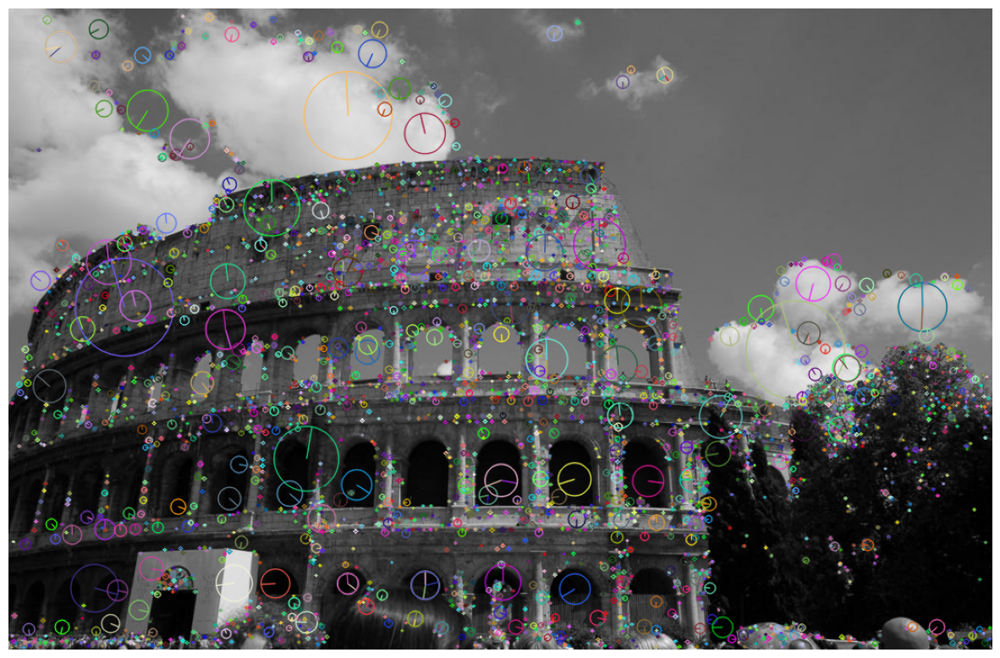

In [9]:
sift = cv2.SIFT_create()
kp = sift.detect(gray,None)
 
img_kp=cv2.drawKeypoints(gray,kp,img,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
fig = plt.figure(figsize=(15, 15))
plt.imshow(img_kp)
plt.axis('off')
plt.show()

Binary-string descriptors: ORB, BRIEF, BRISK, FREAK, AKAZE, etc.

Floating-point descriptors: SIFT, SURF, GLOH, etc.

Feature matching of binary descriptors can be efficiently done by comparing their Hamming distance as opposed to Euclidean distance used for floating-point descriptors.

For comparing binary descriptors in OpenCV, use FLANN + LSH index or Brute Force + Hamming distance.

In [10]:
# consider with 2 images 
# based on these pairs, you can get the key points 
# of the images that are present in both images
key_pair=list(conv_dict.keys())
for i in range(0,len(key_pair)):
    key_pair[i]=key_pair[i].split('-')

In [11]:
def SIFT_feat(img,n_feature):
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    n_feature=1000
    sift_detector=cv2.SIFT.create(nfeatures=n_feature,edgeThreshold=100,)
    kp,desc=sift_detector.detectAndCompute(gray,None)

    return kp[:n_feature],desc[:n_feature]

In [12]:
def BuildCompositeImage(im1, im2, axis=1, margin=0, background=1):
    '''Convenience function to stack two images with different sizes.'''
    
    if background != 0 and background != 1:
        background = 1
    if axis != 0 and axis != 1:
        raise RuntimeError('Axis must be 0 (vertical) or 1 (horizontal')

    h1, w1, _ = im1.shape
    h2, w2, _ = im2.shape

    if axis == 1:
        composite = np.zeros((max(h1, h2), w1 + w2 + margin, 3), dtype=np.uint8) + 255 * background
        if h1 > h2:
            voff1, voff2 = 0, (h1 - h2) // 2
        else:
            voff1, voff2 = (h2 - h1) // 2, 0
        hoff1, hoff2 = 0, w1 + margin
    else:
        composite = np.zeros((h1 + h2 + margin, max(w1, w2), 3), dtype=np.uint8) + 255 * background
        if w1 > w2:
            hoff1, hoff2 = 0, (w1 - w2) // 2
        else:
            hoff1, hoff2 = (w2 - w1) // 2, 0
        voff1, voff2 = 0, h1 + margin
    composite[voff1:voff1 + h1, hoff1:hoff1 + w1, :] = im1
    composite[voff2:voff2 + h2, hoff2:hoff2 + w2, :] = im2

    return (composite, (voff1, voff2), (hoff1, hoff2))

In [13]:
# your pair
n=494
n_feature=50000

pair=key_pair[n]
first=pair[0]
second=pair[1]

img1=cv2.imread(f'{src}/{scene}/images/{first}.jpg')
img2=cv2.imread(f'{src}/{scene}/images/{second}.jpg')

gray1=cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
gray2=cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
print (f'Your pair of image 1){pair[0]}, 2){pair[1]}')

Your pair of image 1)27316552_8126547647, 2)03987349_9672953478


FLANN (Fast Library for Approximate Nearest Neighbors) is a library for fast nearest neighbor search in high-dimensional spaces. It is widely used in computer vision and machine learning applications, particularly in tasks such as feature matching, object recognition, and clustering.

Comparison with Other Libraries:

FLANN is often compared with other libraries such as:

1) ANN (Approximate Nearest Neighbors): ANN is another popular library for nearest neighbor search, but it is slower than FLANN.  
2) KDTREE: KDTREE is a library for k-d tree-based nearest neighbor search, but it is not as scalable as FLANN.  
3) Annoy (Approximate Nearest Neighbors Oh Yeah!): Annoy is a library for nearest neighbor search that is similar to FLANN, but it is more focused on scalability and performance.  

Overall, FLANN is a powerful library for nearest neighbor search that is widely used in computer vision and machine learning applications. Its fast and efficient search algorithms make it suitable for large-scale applications.

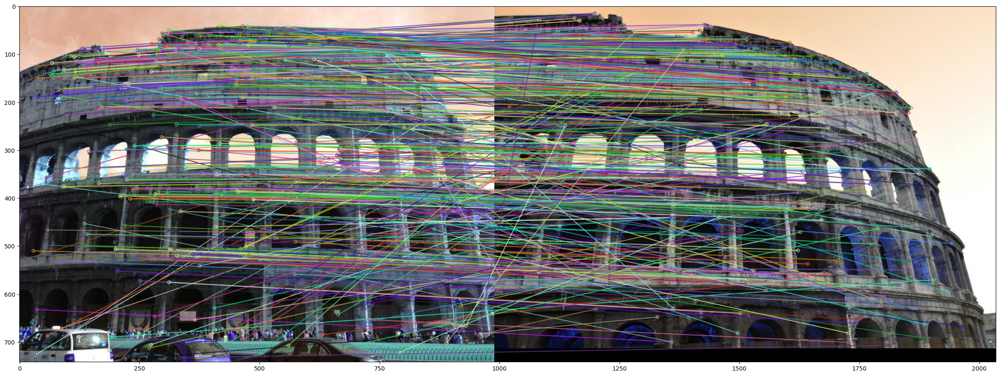

In [14]:
sift = cv2.SIFT.create(nOctaveLayers=2)
kp_1,desc_1=sift.detectAndCompute(img1,None)
kp_2,desc_2=sift.detectAndCompute(img2,None)

# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(desc_1,desc_2,k=2)
pts1 = []
pts2 = []
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        pts2.append(kp_2[m.trainIdx].pt)
        pts1.append(kp_1[m.queryIdx].pt)

# choose algorithm
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 8)
search_params = dict (check = 100) # Specify the number of recursions

flann = cv2.FlannBasedMatcher(index_params, search_params)
matcher = cv2.DescriptorMatcher_create(cv2.DescriptorMatcher_FLANNBASED)
matches = flann.knnMatch(desc_1, desc_2,k=2)

# Filter matches using the Lowe's ratio test
knn_matches = matcher.knnMatch(desc_1, desc_2, 2)
ratio_thresh = 0.8
good_matches = []
for m,n in knn_matches:
    if m.distance < ratio_thresh * n.distance:
        good_matches.append(m)

# Draw matches
img_matches = np.empty((max(img1.shape[0], img2.shape[0]), img1.shape[1]+img2.shape[1], 4), dtype=np.uint8)
filtred_match=cv2.drawMatches(img1, kp_1, img2, kp_2, good_matches, img_matches, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
# Show detected matches
fig = plt.figure(figsize=(30, 30))
plt.imshow( filtred_match)
plt.show()

it's not enought

### Try with kornia models

After looking at the solutions of others and searching for information on the Internet, I found a more accurate method. The Kornia library helped me with this LoFTR (Local Features with Transformers) 

LoFTR is a neural network-based architecture that detects and matches local features in images. It uses a transformer-based encoder to extract features from images and a coarse-to-fine matching strategy to establish correspondences between features.  

Key Components of LoFTR:  

Transformer-based Encoder: LoFTR uses a transformer-based encoder to extract features from images. The encoder takes an image as input and outputs a set of feature maps that capture local information.
Feature Detection: LoFTR detects local features in the feature maps using a learned detector. The detector outputs a set of keypoints and their corresponding descriptors.
Coarse-to-Fine Matching: LoFTR uses a coarse-to-fine matching strategy to establish correspondences between features. The strategy involves first matching features at a coarse scale and then refining the matches at a finer scale.
Mutual Nearest Neighbor: LoFTR uses a mutual nearest neighbor (MNN) strategy to filter out incorrect matches. The MNN strategy involves checking if a feature in one image is the nearest neighbor of a feature in the other image.  

Advantages of LoFTR:
1) Improved Accuracy: LoFTR has been shown to outperform traditional feature detection and matching methods, such as SIFT and ORB, in terms of accuracy.
2) Robustness to Noise and Occlusion: LoFTR is robust to noise and occlusion in images, making it suitable for real-world applications.
3) Flexibility: LoFTR can be used for a variety of tasks, including image matching, object recognition, and 3D reconstruction.

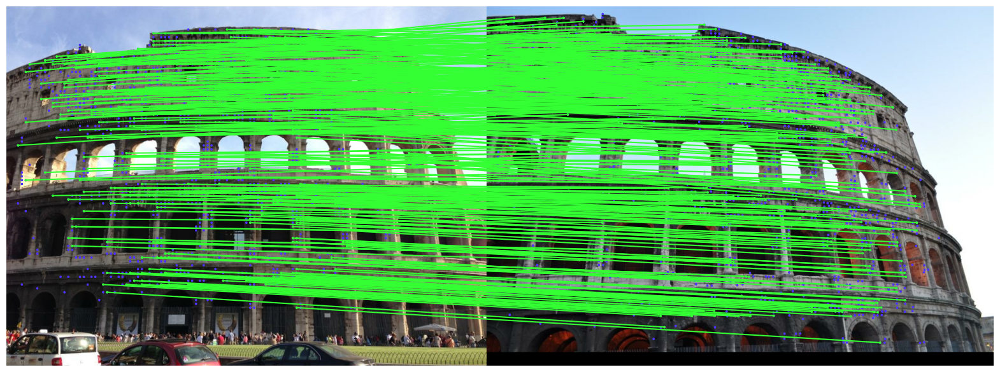

In [15]:
import matplotlib.pyplot as plt
import cv2
import kornia as K
import kornia.feature as KF
import numpy as np
import torch
import kornia_moons.feature
import random


# load images function
def load_torch_image(fname):
    img = K.image_to_tensor(cv2.imread(fname), False).float() / 255
    img = K.color.bgr_to_rgb(img)
    return img
    
# 2 different images
img1 = load_torch_image(f'{src}/{scene}/images/{first}.jpg')
img2 = load_torch_image(f'{src}/{scene}/images/{second}.jpg')

matcher = KF.LoFTR(pretrained='outdoor')

input_dict = {'image0': K.color.rgb_to_grayscale(img1),
              'image1': K.color.rgb_to_grayscale(img2)}

with torch.no_grad():
    correspondences = matcher(input_dict)


mask = correspondences['confidence'] > 0.9
indices = torch.nonzero(mask)
correspondences['confidence'] = correspondences['confidence'][indices]
correspondences['keypoints0'] = correspondences['keypoints0'][indices]
correspondences['keypoints1'] = correspondences['keypoints1'][indices]
correspondences['batch_indexes'] = correspondences['batch_indexes'][indices]

mkpts0 = correspondences['keypoints0'].cpu().numpy()
mkpts1 = correspondences['keypoints1'].cpu().numpy()

# an additional filter for matching points. at this stage
# the options for perspective distortion due to a change in the shooting angle are calculated
H, inliers = cv2.findFundamentalMat(mkpts0, mkpts1, cv2.USAC_MAGSAC, 0.5, 0.999, 100000)
inliers = inliers > 0

# Функция отрисовки совпадений
# Match rendering function
kornia_moons.feature.draw_LAF_matches(
    KF.laf_from_center_scale_ori(torch.from_numpy(mkpts0).view(1,-1, 2),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1)),

    KF.laf_from_center_scale_ori(torch.from_numpy(mkpts1).view(1,-1, 2),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1)),
    torch.arange(mkpts0.shape[0]).view(-1,1).repeat(1,2),
    K.tensor_to_image(img1),
    K.tensor_to_image(img2),
    inliers,
    draw_dict={'inlier_color': (0.2, 1, 0.2),
               'tentative_color': None,
               'feature_color': (0.3, 0.2, 1), 'vertical': False})

plt.axis('off')
plt.show()

goooood

### let's calculate how far apart the images are from the parameters given to

In [18]:
inliers=np.reshape(inliers,len(inliers))
numerate_inliners=list(enumerate(inliers))

# search positive inliners, which match in USAC_MAGSAC fundamental matrix
pos_inliner_0=[mkpts0[cur[0]][0] for cur in numerate_inliners if cur[1] ]
pos_inliner_1=[mkpts1[cur[0]][0] for cur in numerate_inliners if cur[1] ]

# train image under consideration
print(f'First image id {first}')
print(f'Second image id {second}')

First image id 27316552_8126547647
Second image id 03987349_9672953478


In [19]:
# auxiliary functions which free in use 
def NormalizeKeypoints(keypoints, K):
    C_x = K[0, 2]
    C_y = K[1, 2]
    f_x = K[0, 0]
    f_y = K[1, 1]
    keypoints = (keypoints - np.array([[C_x, C_y]])) / np.array([[f_x, f_y]])
    return keypoints

def ComputeErrorForOneExample(q_gt, T_gt, q, T, scale):
    '''Compute the error metric for a single example.
    
    The function returns two errors, over rotation and translation. These are combined at different thresholds by ComputeMaa in order to compute the mean Average Accuracy.'''
    eps = 1e-15
    q_gt_norm = q_gt / (np.linalg.norm(q_gt) + eps)
    q_norm = q / (np.linalg.norm(q) + eps)

    loss_q = np.maximum(eps, (1.0 - np.sum(q_norm * q_gt_norm)**2))
    err_q = np.arccos(1 - 2 * loss_q)

    # Apply the scaling factor for this scene.
    T_gt_scaled = T_gt * scale
    T_scaled = T * np.linalg.norm(T_gt) * scale / (np.linalg.norm(T) + eps)

    err_t = min(np.linalg.norm(T_gt_scaled - T_scaled), np.linalg.norm(T_gt_scaled + T_scaled))

    return err_q * 180 / np.pi, err_t

In [20]:
# matrix calibration for first and second img in pair
K1=calibration[first][0]
K2=calibration[second][0]

The essential matrix is a specialization of the fundamental matrix in the case of normalized image coordinates. And the fundamental matrix can be considered as a generalization of the essential matrix, in which the assumption of calibrated cameras is removed. The basic matrix has fewer degrees of freedom and additional properties compared to the fundamental matrix.

In [21]:
# We found a fundamental matrix based on the learning model
EE=K.geometry.epipolar.essential_from_fundamental(H,K1,K2)
print (EE)
# normalized the points that fit after the match
kp1n = NormalizeKeypoints(pos_inliner_0[0], K1)
kp2n = NormalizeKeypoints(pos_inliner_1[0], K2)

# Restores the relative rotation of the camera and translation based on the assumed essential matrix and the corresponding points
# in two images using chirality checking.
# Returns the number of tabs that have been verified.
num_inliers, R, T, mask = cv2.recoverPose(E=EE, points1=kp1n, points2=kp2n)

# Transform the 3x3 rotation matrix into a 4d quaternion vector.
# Convert the quaternion vector to the angle of rotation of the axis in radians.
qq=K.geometry.conversions.rotation_matrix_to_quaternion(torch.tensor(R))

# decomposing the matrix into a vector
T = T.flatten()

[[1160.97681852 1604.64558182 1048.03756886]
 [ 790.57231028 1096.28234503  712.7601544 ]
 [   2.22206585    3.0690579     2.00645236]]


In [22]:
# relative difference in poses for a pair of images
# we take the rotation matrix and the translation wind from the 1st and 2nd images
R1_gt, T1_gt = np.array(calibration[first][1]), np.array(calibration[first][2]).reshape((3, 1))
R2_gt, T2_gt = np.array(calibration[second][1]), np.array(calibration[second][2]).reshape((3, 1))

# multiplying the rotation matrices
dR_gt = np.dot(R2_gt, R1_gt.T)
# # calculate the deviations of the transformation vector for 2 images
dT_gt = (T2_gt - np.dot(dR_gt, T1_gt)).flatten()
# very small value
eps = 1e-15

In [23]:
# # calculating the quaternion vector for dR_gt
# this is primarily a tool that describes the action of rotating around an axis at a given angle:
qq_1=K.geometry.conversions.rotation_matrix_to_quaternion(torch.tensor(dR_gt))
# normalize
qq_1 = qq_1 / (np.linalg.norm(qq_1) + eps)
print(qq_1)

tensor([ 0.9717, -0.0714, -0.2167,  0.0609], dtype=torch.float64)


In [24]:
scaling_dict = {}
with open(f'{src}/scaling_factors.csv') as f:
    reader = csv.reader(f, delimiter=',')
    for i, row in enumerate(reader):
        # Skip header.
        if i == 0:
            continue
        scaling_dict[row[0]] = float(row[1])


In [25]:
# # calculate deviations based on a given metric
err_q, err_t = ComputeErrorForOneExample(np.array(qq_1), dT_gt, np.array(qq), T, scaling_dict[scene])
print(f'Pair "{pair}, rotation_error={err_q:.02f} (deg), translation_error={err_t:.02f} (m)', flush=True)

Pair "['27316552_8126547647', '03987349_9672953478'], rotation_error=125.37 (deg), translation_error=85.82 (m)


### Try with datasets

In [29]:
# In competion use two different sets of thresholds over rotation and translation. 
# Do not change this -- these are the values used by the scoring back-end.
thresholds_q = np.linspace(1, 10, 10)
thresholds_t = np.geomspace(0.2, 5, 10)

In [30]:
# Save the per-sample errors and the accumulated metric to dictionaries, for later inspection.
errors = {scene: {} for scene in scaling_dict.keys()}
mAA = {scene: {} for scene in scaling_dict.keys()}

In [31]:
max_pairs=5

In [32]:
def ComputeMaa(err_q, err_t, thresholds_q, thresholds_t):
    '''Compute the mean Average Accuracy at different tresholds, for one scene.'''
    
    assert len(err_q) == len(err_t)
    
    acc, acc_q, acc_t = [], [], []
    for th_q, th_t in zip(thresholds_q, thresholds_t):
        acc += [(np.bitwise_and(np.array(err_q) < th_q, np.array(err_t) < th_t)).sum() / len(err_q)]
        acc_q += [(np.array(err_q) < th_q).sum() / len(err_q)]
        acc_t += [(np.array(err_t) < th_t).sum() / len(err_t)]
    return np.mean(acc), np.array(acc), np.array(acc_q), np.array(acc_t)

In [33]:
def Scene_mean_error(scene,max_pairs):

    def load_torch_image(fname):
        img = K.image_to_tensor(cv2.imread(fname), False).float() / 255
        img = K.color.bgr_to_rgb(img)
        return img
    
    conv_dict = Covisibility(f'{src}/{scene}/pair_covisibility.csv') 
    calibration=Calibration(f'{src}/{scene}/calibration.csv')

    errors = {}
    mAA = {}

    pairs=[pairs for pairs,covisibility in conv_dict.items() if covisibility[0]>=0.2]
    random.shuffle(pairs)
    pairs = pairs[:max_pairs]

    # Process the pairs.
    max_err_acc_q_new = []
    max_err_acc_t_new = []

    for counter, pair in enumerate(pairs):
        id1, id2 = pair.split('-')

        # 2 different images
        img1 = load_torch_image(f'{src}/{scene}/images/{id1}.jpg')
        img2 = load_torch_image(f'{src}/{scene}/images/{id2}.jpg')

        matcher = KF.LoFTR(pretrained='outdoor')

        input_dict = {'image0': K.color.rgb_to_grayscale(img1),
                        'image1': K.color.rgb_to_grayscale(img2)}

        with torch.no_grad():
            correspondences = matcher(input_dict)

        mask = correspondences['confidence'] > 0.9
        indices = torch.nonzero(mask)
        correspondences['confidence'] = correspondences['confidence'][indices]
        correspondences['keypoints0'] = correspondences['keypoints0'][indices]
        correspondences['keypoints1'] = correspondences['keypoints1'][indices]
        correspondences['batch_indexes'] = correspondences['batch_indexes'][indices]

        mkpts0 = correspondences['keypoints0'].cpu().numpy()
        mkpts1 = correspondences['keypoints1'].cpu().numpy()
        H, inliers = cv2.findFundamentalMat(mkpts0, mkpts1, cv2.USAC_MAGSAC, 0.5, 0.999, 100000)
        inliers = inliers > 0


        # Match rendering function
        kornia_moons.feature.draw_LAF_matches(
            KF.laf_from_center_scale_ori(torch.from_numpy(mkpts0).view(1,-1, 2),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1)),

            KF.laf_from_center_scale_ori(torch.from_numpy(mkpts1).view(1,-1, 2),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1)),
            torch.arange(mkpts0.shape[0]).view(-1,1).repeat(1,2),
            K.tensor_to_image(img1),
            K.tensor_to_image(img2),
            inliers,
            draw_dict={'inlier_color': (0.2, 1, 0.2),
               'tentative_color': None,
               'feature_color': (0.3, 0.2, 1), 'vertical': False})

        plt.axis('off')
        plt.show()


        inliers=np.reshape(inliers,len(inliers))
        numerate_inliners=list(enumerate(inliers))

        # search positive inliners, which match in USAC_MAGSAC fundamental matrix
        pos_inliner_0=[mkpts0[cur[0]][0] for cur in numerate_inliners if cur[1] ]
        pos_inliner_1=[mkpts1[cur[0]][0] for cur in numerate_inliners if cur[1] ]

        # matrix calibration for first and second img in pair
        K1=calibration[id1][0]
        K2=calibration[id2][0]

        EE=K.geometry.epipolar.essential_from_fundamental(H,K1,K2)

        kp1n = NormalizeKeypoints(pos_inliner_0[0], K1)
        kp2n = NormalizeKeypoints(pos_inliner_1[0], K2)

        num_inliers, R, T, mask = cv2.recoverPose(EE, kp1n, kp2n)

        qq=K.geometry.conversions.rotation_matrix_to_quaternion(torch.tensor(R))

        T = T.flatten()

        R1_gt, T1_gt = np.array(calibration[id1][1]), np.array(calibration[id1][2]).reshape((3, 1))
        R2_gt, T2_gt = np.array(calibration[id2][1]), np.array(calibration[id2][2]).reshape((3, 1))

        dR_gt = np.dot(R2_gt, R1_gt.T)
        
        dT_gt = (T2_gt - np.dot(dR_gt, T1_gt)).flatten()
        
        eps = 1e-15

        qq_1=K.geometry.conversions.rotation_matrix_to_quaternion(torch.tensor(dR_gt))
        qq_1 = qq_1 / (np.linalg.norm(qq_1) + eps)
        
        err_q, err_t = ComputeErrorForOneExample(np.array(qq_1), dT_gt, np.array(qq), T, scaling_dict[scene])
        print(f'Pair "{pair}, rotation_error={err_q:.02f} (deg), translation_error={err_t:.02f} (m)', flush=True)
        
        errors[pair] = [err_q, err_t]
        
        mAA = ComputeMaa([v[0] for v in errors.values()], [v[1] for v in errors.values()], thresholds_q, thresholds_t)
    print(f'Mean average Accuracy on "{scene}": {mAA[0]:.05f}')
    print()

    return mAA

keypoints0
keypoints1
confidence
batch_indexes


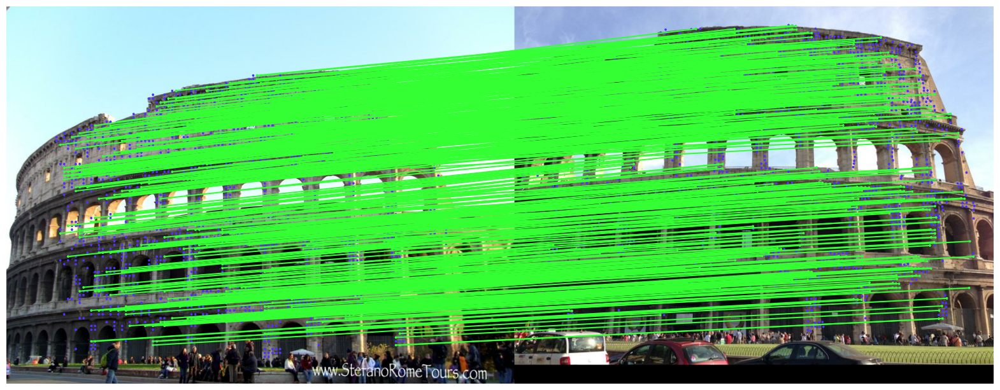

Pair "57970218_7170005470-27316552_8126547647, rotation_error=102.69 (deg), translation_error=65.42 (m)
keypoints0
keypoints1
confidence
batch_indexes


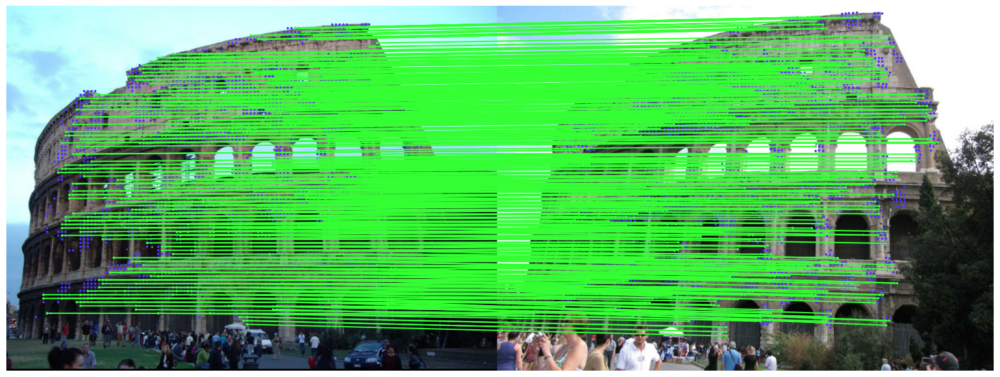

Pair "72691336_2756600002-33729039_5520712742, rotation_error=178.05 (deg), translation_error=15.93 (m)
keypoints0
keypoints1
confidence
batch_indexes


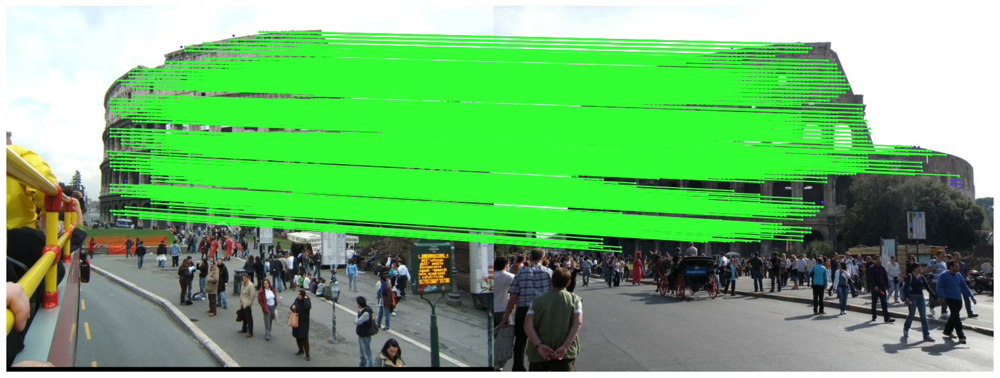

Pair "41311579_5746625930-20720664_5114461881, rotation_error=137.05 (deg), translation_error=14.47 (m)
keypoints0
keypoints1
confidence
batch_indexes


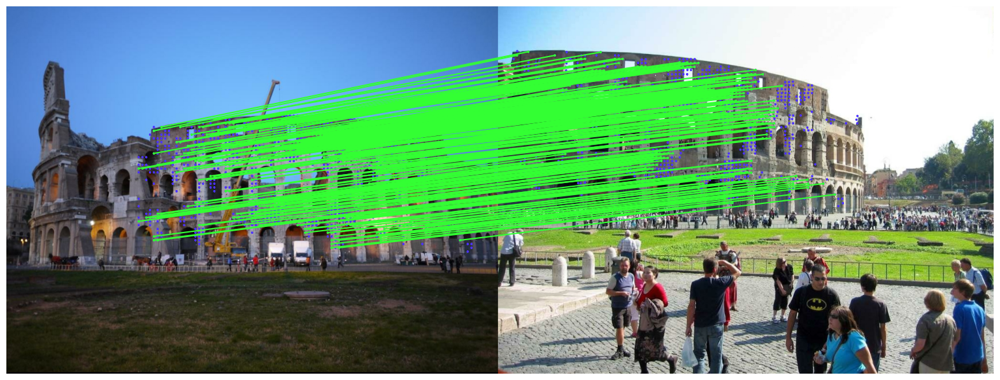

Pair "86638924_8465510547-20128816_1600598724, rotation_error=178.36 (deg), translation_error=16.92 (m)
keypoints0
keypoints1
confidence
batch_indexes


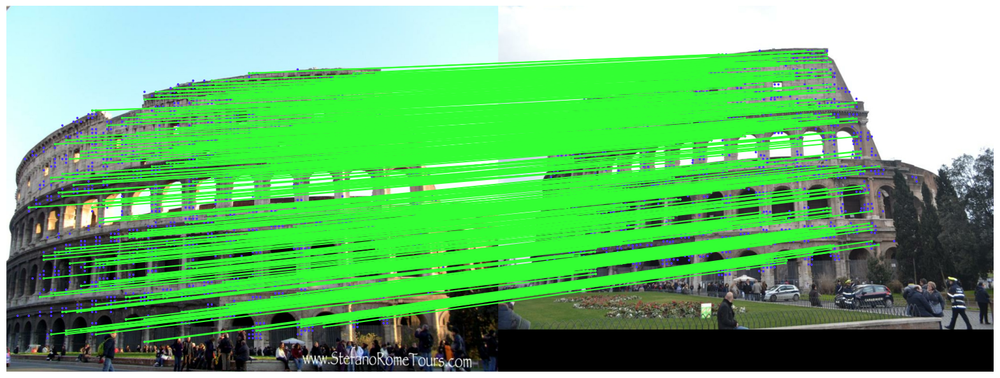

Pair "57970218_7170005470-43360582_8504647701, rotation_error=176.69 (deg), translation_error=10.71 (m)

Mean average Accuracy on "colosseum_exterior": 0.00000



In [34]:
rr=Scene_mean_error(scene=scene,max_pairs=5)

---

### Test

In [38]:
import pandas as pd

sub=pd.read_csv(r'E:\mphti\training\ICM22\sample_submission.csv')
sub

,sample_id,fundamental_matrix
0,googleurban;1cf87530;a5a9975574c94ff9a285f58c3...,0.06377171256744407 0.013457351355713576 0.348...
1,googleurban;6ceaefff;39563e58b2b7411da3f06427c...,0.9482570558218754 0.22187106097992249 0.64012...
2,googleurban;d91db836;81dd07fb7b9a4e01996cee637...,0.11050136659424259 0.7987936275204097 0.06535...


In [39]:
def LoFTR_2img(img1_dir,img2_dir):

    # load images function
    def load_torch_image(fname):
        img = K.image_to_tensor(cv2.imread(fname), False).float() / 255
        img = K.color.bgr_to_rgb(img)
        return img
    
    # 2 different images
    img1 = load_torch_image(img1_dir)
    img2 = load_torch_image(img2_dir)

    matcher = KF.LoFTR(pretrained='outdoor')

    input_dict = {'image0': K.color.rgb_to_grayscale(img1),
                'image1': K.color.rgb_to_grayscale(img2)}

    with torch.no_grad():
        correspondences = matcher(input_dict)



    mask = correspondences['confidence'] > 0.8
    indices = torch.nonzero(mask)
    correspondences['confidence'] = correspondences['confidence'][indices]
    correspondences['keypoints0'] = correspondences['keypoints0'][indices]
    correspondences['keypoints1'] = correspondences['keypoints1'][indices]
    correspondences['batch_indexes'] = correspondences['batch_indexes'][indices]

    mkpts0 = correspondences['keypoints0'].cpu().numpy()
    mkpts1 = correspondences['keypoints1'].cpu().numpy()
    H, inliers = cv2.findFundamentalMat(mkpts0, mkpts1, cv2.USAC_MAGSAC, 0.5, 0.999, 100000)
    inliers = inliers > 0


    # Match rendering function
    kornia_moons.feature.draw_LAF_matches(
        KF.laf_from_center_scale_ori(torch.from_numpy(mkpts0).view(1,-1, 2),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts0.shape[0]).view(1,-1, 1)),

        KF.laf_from_center_scale_ori(torch.from_numpy(mkpts1).view(1,-1, 2),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1, 1),
                                torch.ones(mkpts1.shape[0]).view(1,-1, 1)),
        torch.arange(mkpts0.shape[0]).view(-1,1).repeat(1,2),
        K.tensor_to_image(img1),
        K.tensor_to_image(img2),
        inliers,
        draw_dict={'inlier_color': (0.2, 1, 0.2),
               'tentative_color': None,
               'feature_color': (0.3, 0.2, 1), 'vertical': False})

    plt.axis('off')
    plt.show()

    return H,inliers

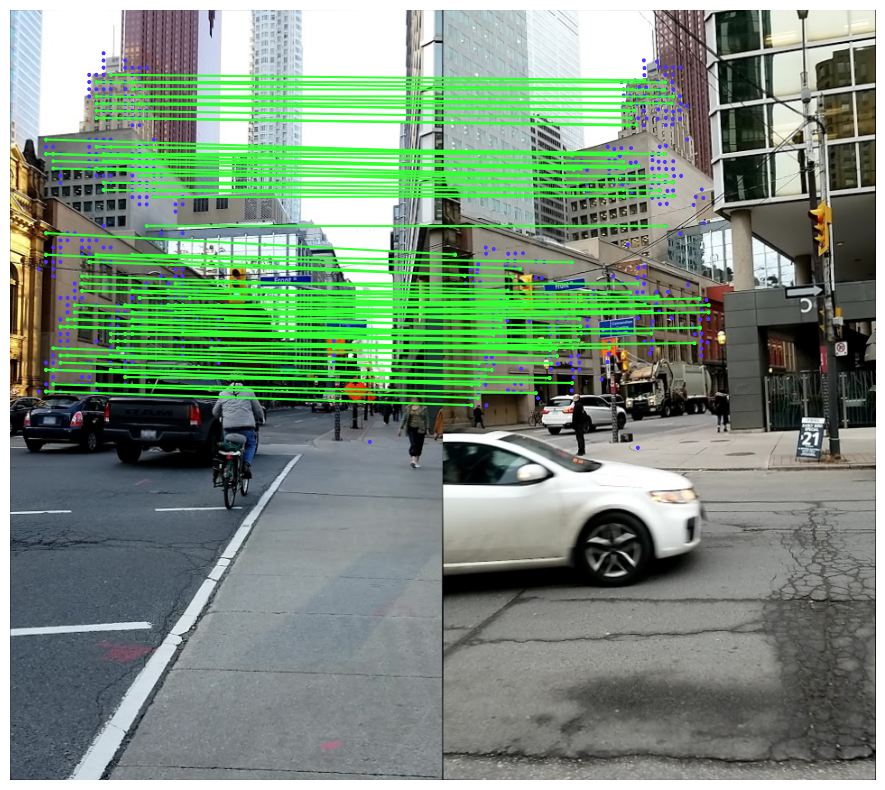

In [44]:
# first pair
H_1,inliers_1=LoFTR_2img(r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\1cf87530\0143f47ee9e54243a1b8454f3e91621a.png',
                         r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\1cf87530\a5a9975574c94ff9a285f58c39b53d2c.png')

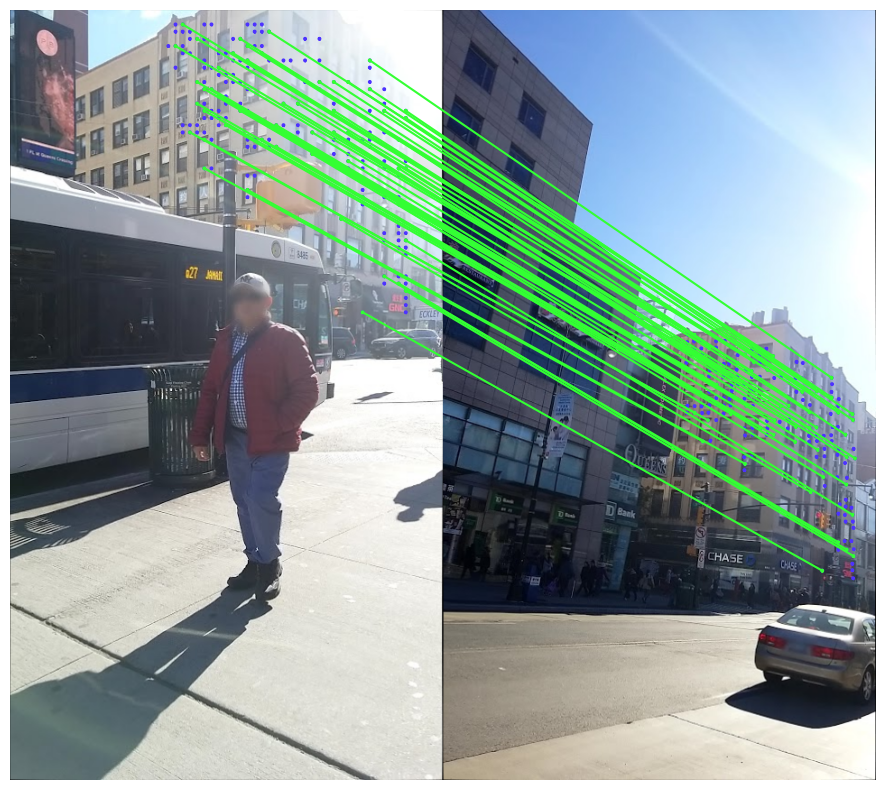

In [45]:
# second pair
H_2,inliers_2=LoFTR_2img(r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\6ceaefff\0303b05ca0cb46959eac430e4b2472ca.png',
                         r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\6ceaefff\39563e58b2b7411da3f06427c9ee4239.png')

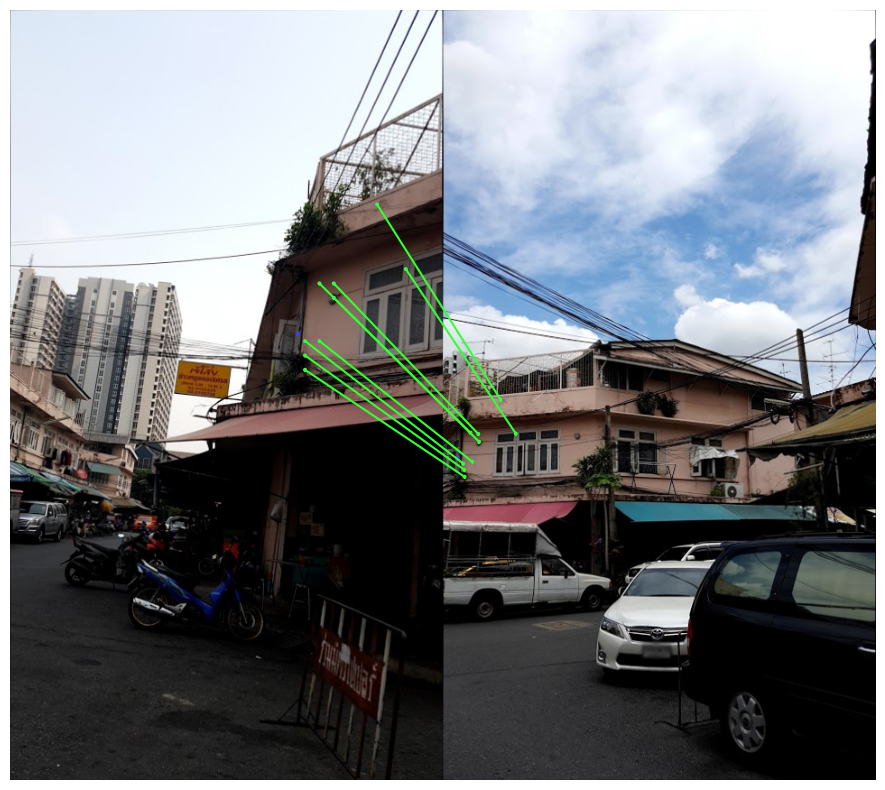

In [46]:
# third pair
H_3,inliers_3=LoFTR_2img(r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\d91db836\0006b1337a0347f49b4e651c035dfa0e.png',
                         r'E:\ds3-spring-2018\kaggle\IMC2022\test_images\d91db836\81dd07fb7b9a4e01996cee637f91ca1a.png')

In [56]:
sub['fundamental_matrix'][0]=H_1.flatten()
sub['fundamental_matrix'][1]=H_2.flatten()
sub['fundamental_matrix'][2]=H_3.flatten()
sub

,sample_id,fundamental_matrix
0,googleurban;1cf87530;a5a9975574c94ff9a285f58c3...,"[-3.195183518251583e-07, 1.0026838039544481e-0..."
1,googleurban;6ceaefff;39563e58b2b7411da3f06427c...,"[-4.825668112965202e-07, -5.0393690926419515e-..."
2,googleurban;d91db836;81dd07fb7b9a4e01996cee637...,"[-1.0900137666052922e-06, -5.50207026536742e-0..."


In [61]:
def FlattenMatrix(M, num_digits=8):
    '''Convenience function to write CSV files.'''
    
    return ' '.join([f'{v:.{num_digits}e}' for v in M.flatten()])

In [64]:
sub['fundamental_matrix'][0]=FlattenMatrix(H_1)
sub['fundamental_matrix'][1]=FlattenMatrix(H_2)
sub['fundamental_matrix'][2]=FlattenMatrix(H_3)
sub

,sample_id,fundamental_matrix
0,googleurban;1cf87530;a5a9975574c94ff9a285f58c3...,-3.19518352e-07 1.00268380e-06 3.82173570e-04 ...
1,googleurban;6ceaefff;39563e58b2b7411da3f06427c...,-4.82566811e-07 -5.03936909e-06 1.53152792e-03...
2,googleurban;d91db836;81dd07fb7b9a4e01996cee637...,-1.09001377e-06 -5.50207027e-06 1.90303813e-03...


In [65]:
sub.to_csv('submission.csv',index=False)